In [26]:
import numpy as np
import matplotlib.pyplot as plt

from keras.models import Model
from keras.models import load_model
from keras.preprocessing import image

fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 12
fig_size[1] = 9

In [4]:
model = load_model('cats_and_dogs_small_2.h5')

In [5]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_37 (Conv2D)           (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_37 (MaxPooling (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_38 (Conv2D)           (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_38 (MaxPooling (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_39 (Conv2D)           (None, 34, 34, 128)       73856     
_________________________________________________________________
max_pooling2d_39 (MaxPooling (None, 17, 17, 128)       0         
_________________________________________________________________
conv2d_40 (Conv2D)           (None, 15, 15, 128)       147584    
__________

In [10]:
SAMPLE_CAT = "datasets/cats_and_dogs2000/test/cats/cat.222.jpg"

In [12]:
img = image.load_img(SAMPLE_CAT, target_size=(150, 150))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor /= 255.

print(img_tensor.shape)

(1, 150, 150, 3)


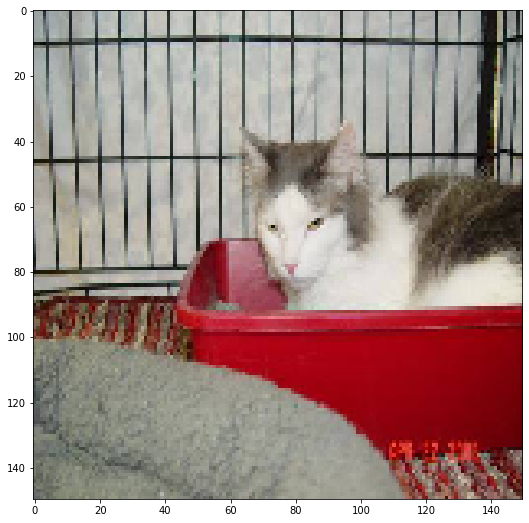

In [28]:
plt.imshow(img_tensor[0])
plt.show()

In [16]:
layer_outputs = [layer.output for layer in model.layers[:8]]

In [17]:
activation_model = Model(inputs=model.input, outputs=layer_outputs)

In [19]:
activations = activation_model.predict(img_tensor)

In [22]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 148, 148, 32)


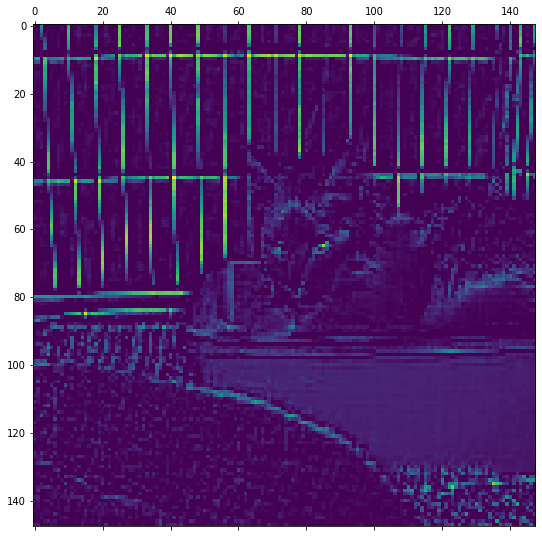

In [40]:
plt.matshow(first_layer_activation[0, :, :, 4], cmap='viridis')
plt.show()

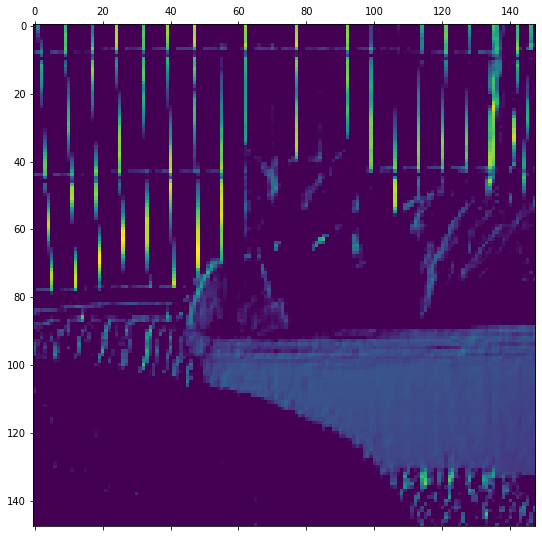

In [63]:
plt.matshow(first_layer_activation[0, :, :, 7], cmap='viridis')
plt.show()

In [65]:
layer_names = [layer.name for layer in model.layers[:8]]
print(layer_names)

['conv2d_37', 'max_pooling2d_37', 'conv2d_38', 'max_pooling2d_38', 'conv2d_39', 'max_pooling2d_39', 'conv2d_40', 'max_pooling2d_40']


In [66]:
images_per_row = 16

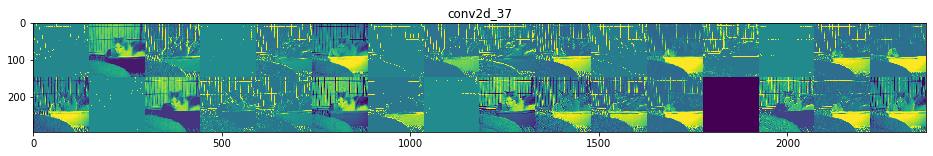

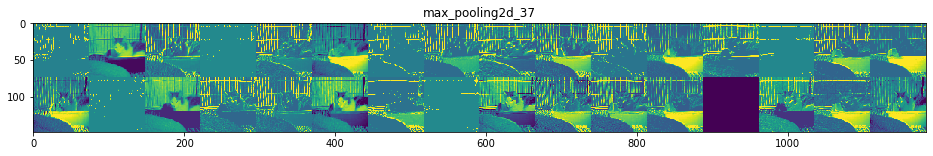

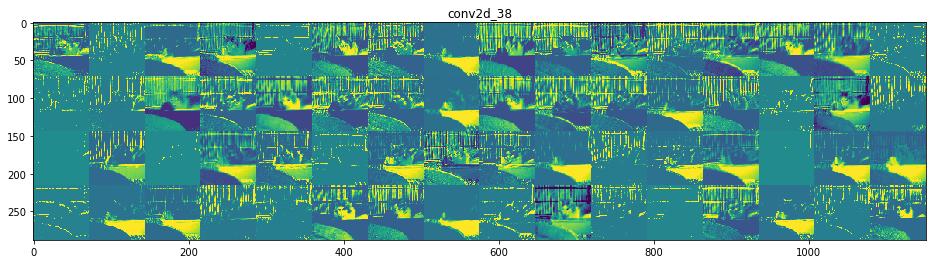

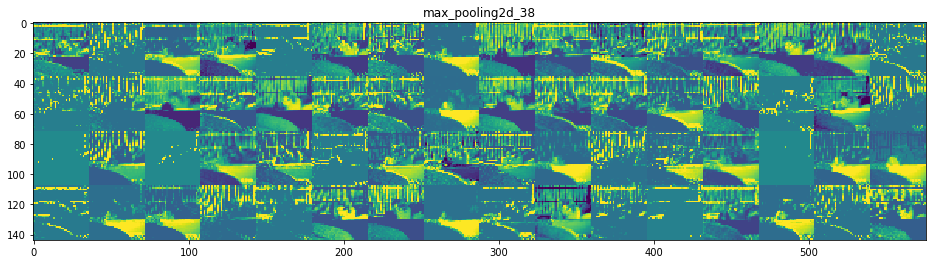

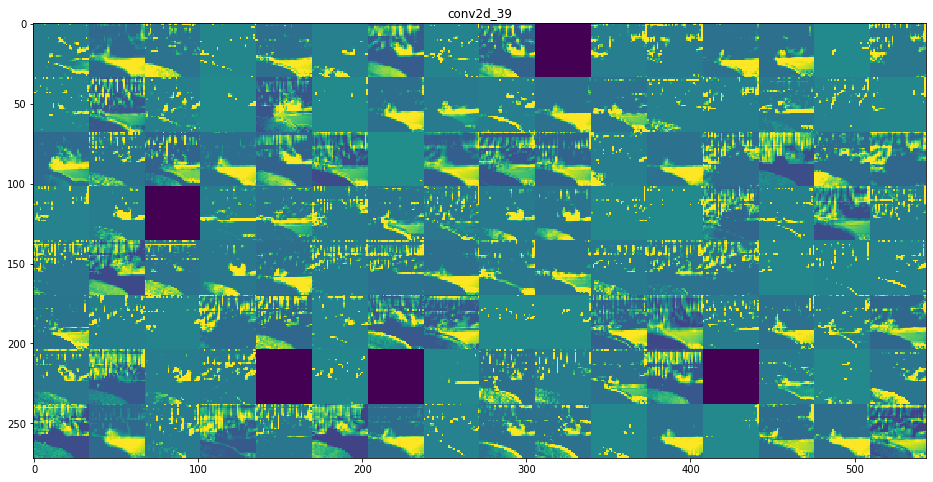

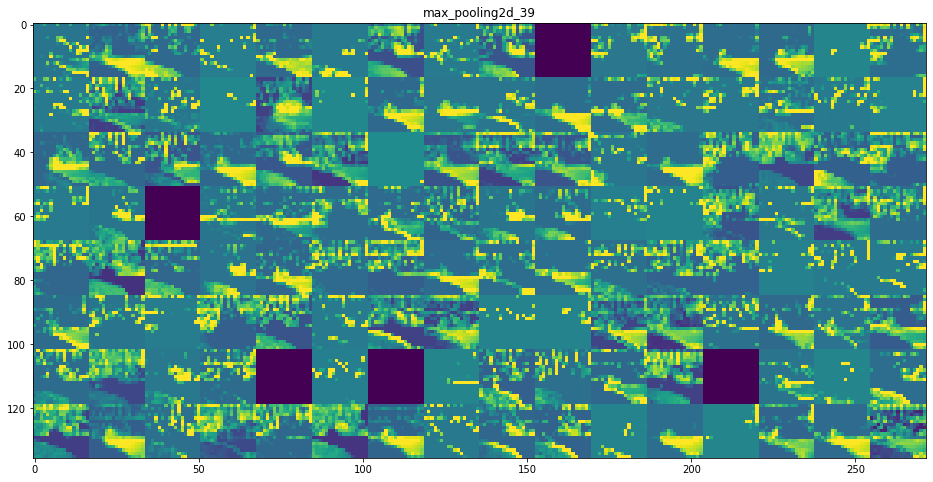

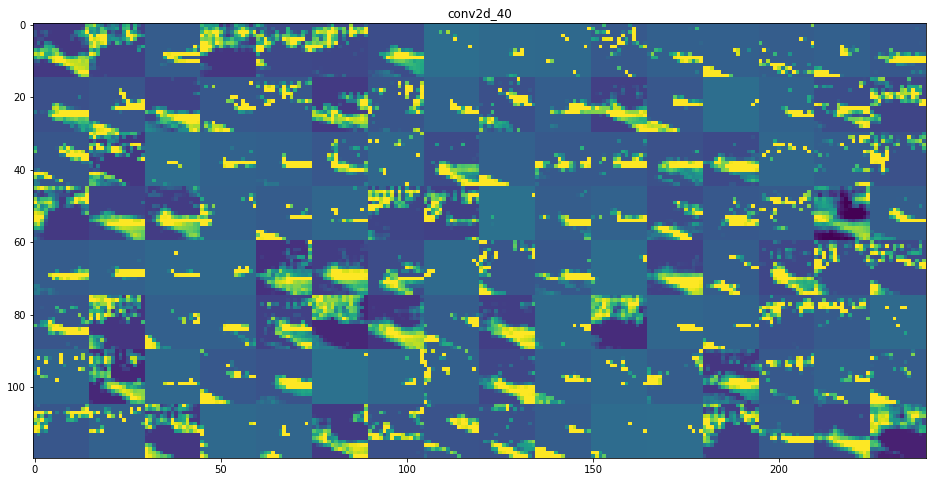

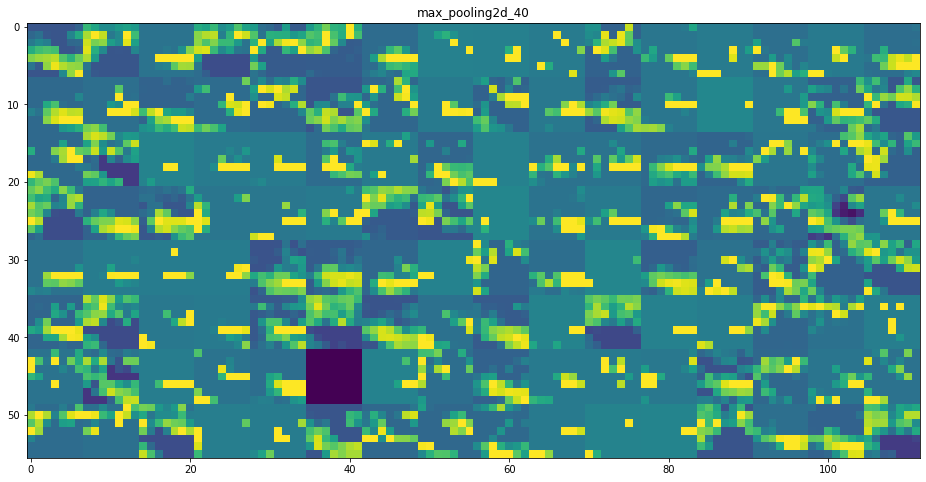

In [68]:
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :, (col * images_per_row) + row]
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col+1) * size,
                         row * size : (row+1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

# Visualizing ConvNet Filters

In [100]:
from keras.applications import VGG16
from keras import backend as K

In [101]:
model = VGG16(weights='imagenet', include_top=False)

In [102]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, None, None, 3)     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0         
__________

In [119]:
model = VGG16(weights='imagenet', include_top=False)

In [120]:
def deprocess_image(x):
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    
    x += 0.5
    x = np.clip(x, 0, 1)
    
    x *= 255.
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [121]:
def generate_pattern(layer_name, filter_index, size=150):
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])
    
    grads = K.gradients(loss, model.input)[0]
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    iterate = K.function([model.input], [loss, grads])
    
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.
    
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

In [135]:
layer_names = [layer.name for layer in model.layers[1:]]
layer_names

['block1_conv1',
 'block1_conv2',
 'block1_pool',
 'block2_conv1',
 'block2_conv2',
 'block2_pool',
 'block3_conv1',
 'block3_conv2',
 'block3_conv3',
 'block3_pool',
 'block4_conv1',
 'block4_conv2',
 'block4_conv3',
 'block4_pool',
 'block5_conv1',
 'block5_conv2',
 'block5_conv3',
 'block5_pool']

Visualizing layer block1_conv1


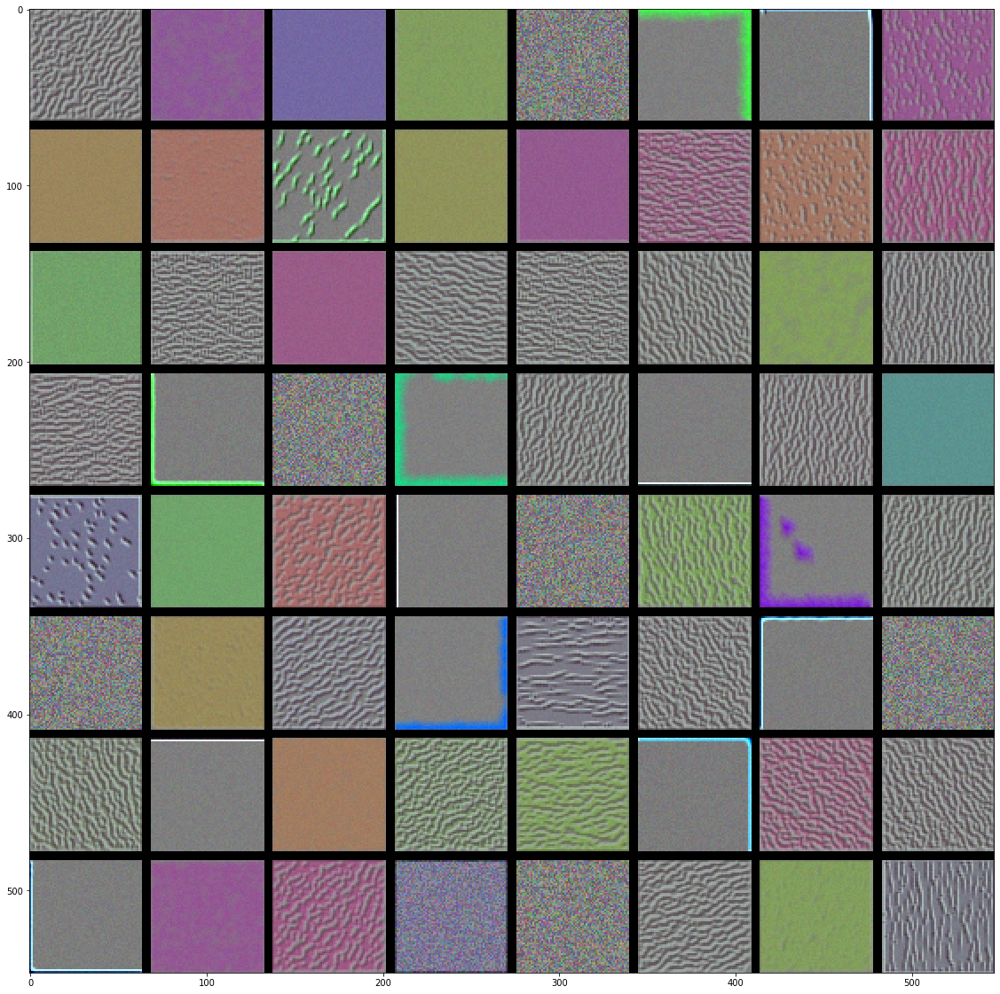

Visualizing layer block1_conv2


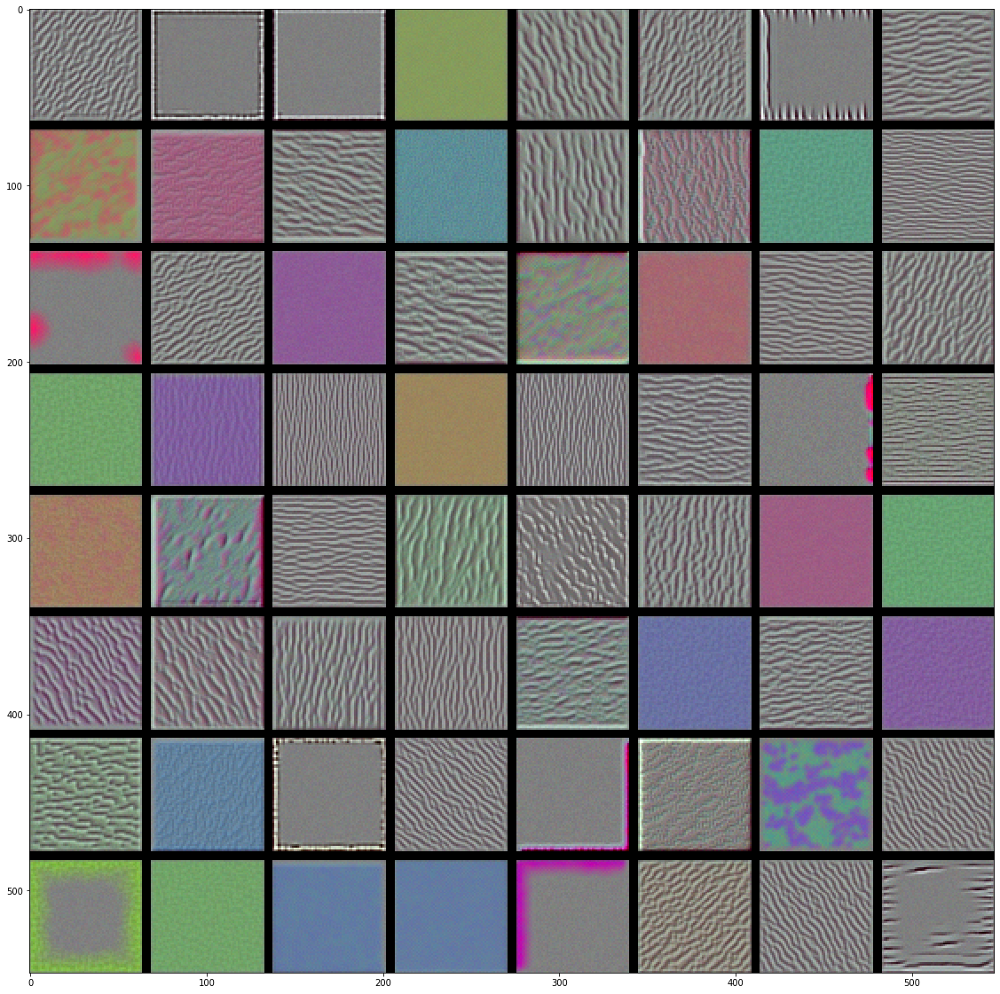

Visualizing layer block1_pool


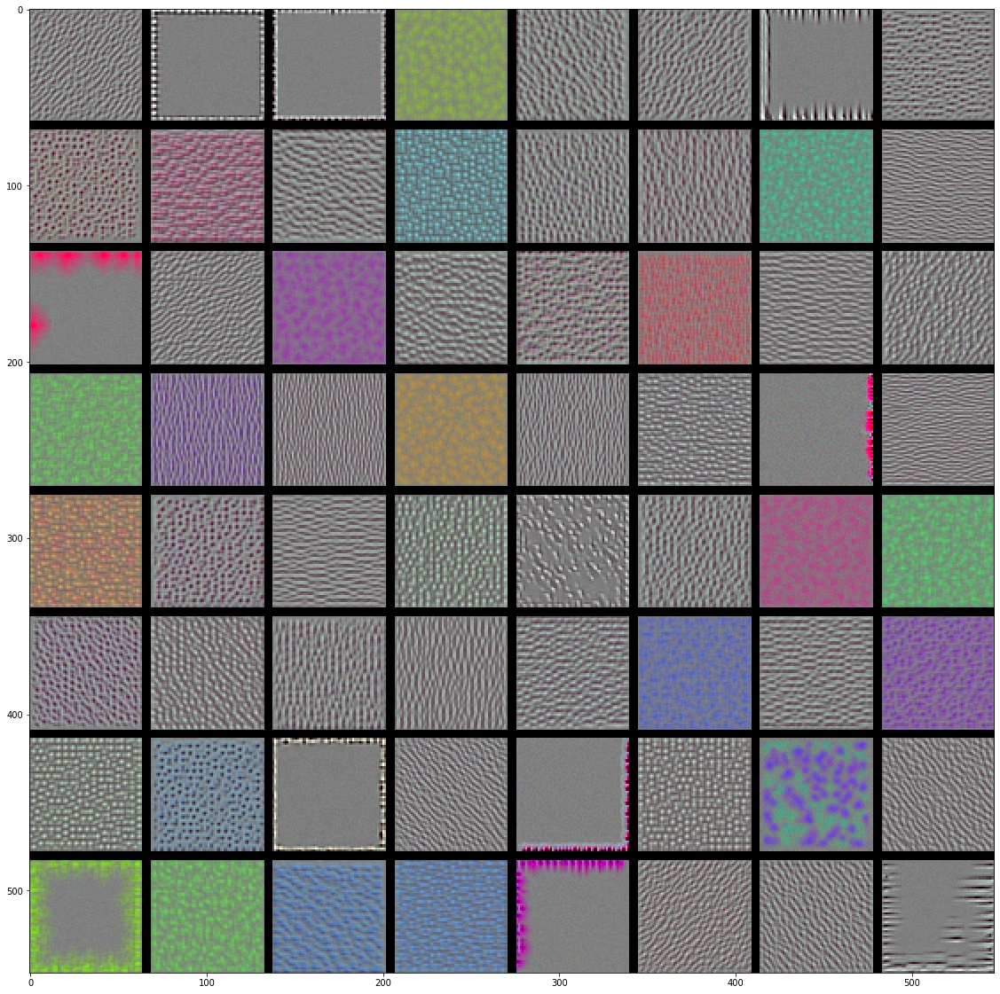

Visualizing layer block2_conv1


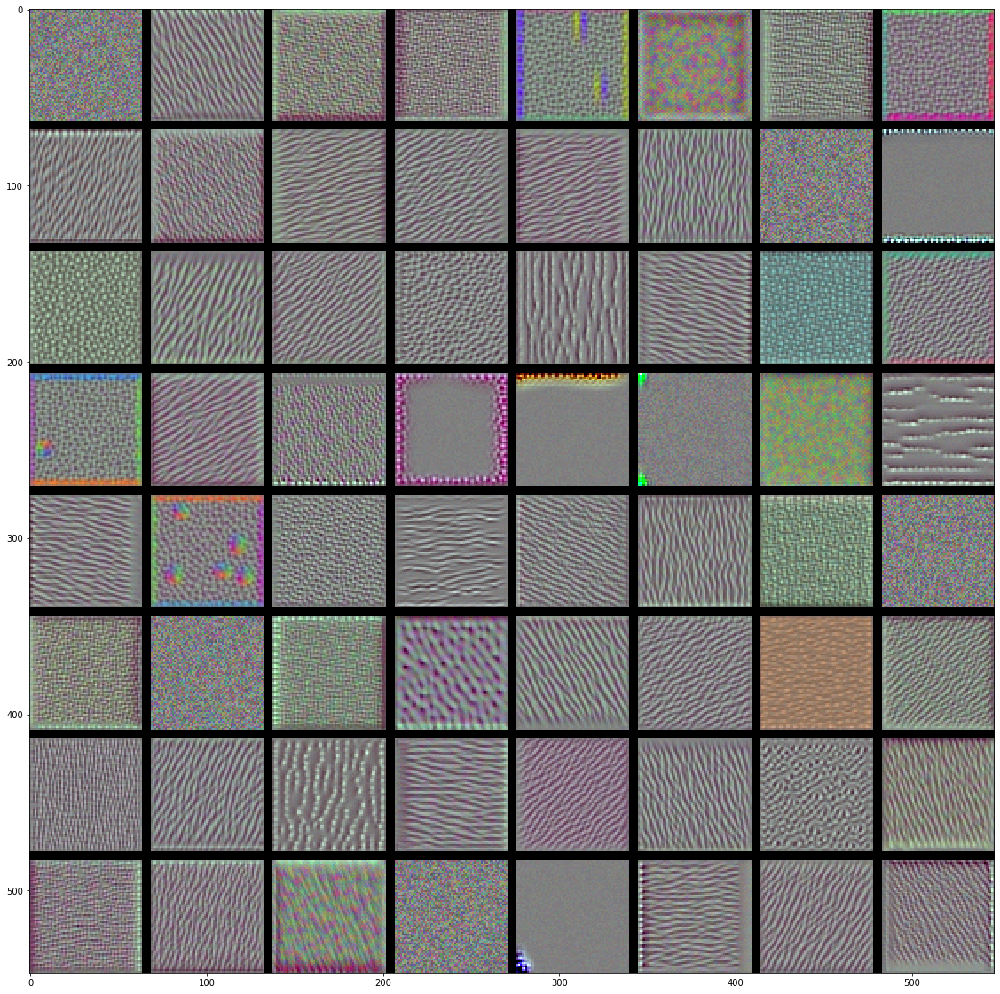

Visualizing layer block2_conv2


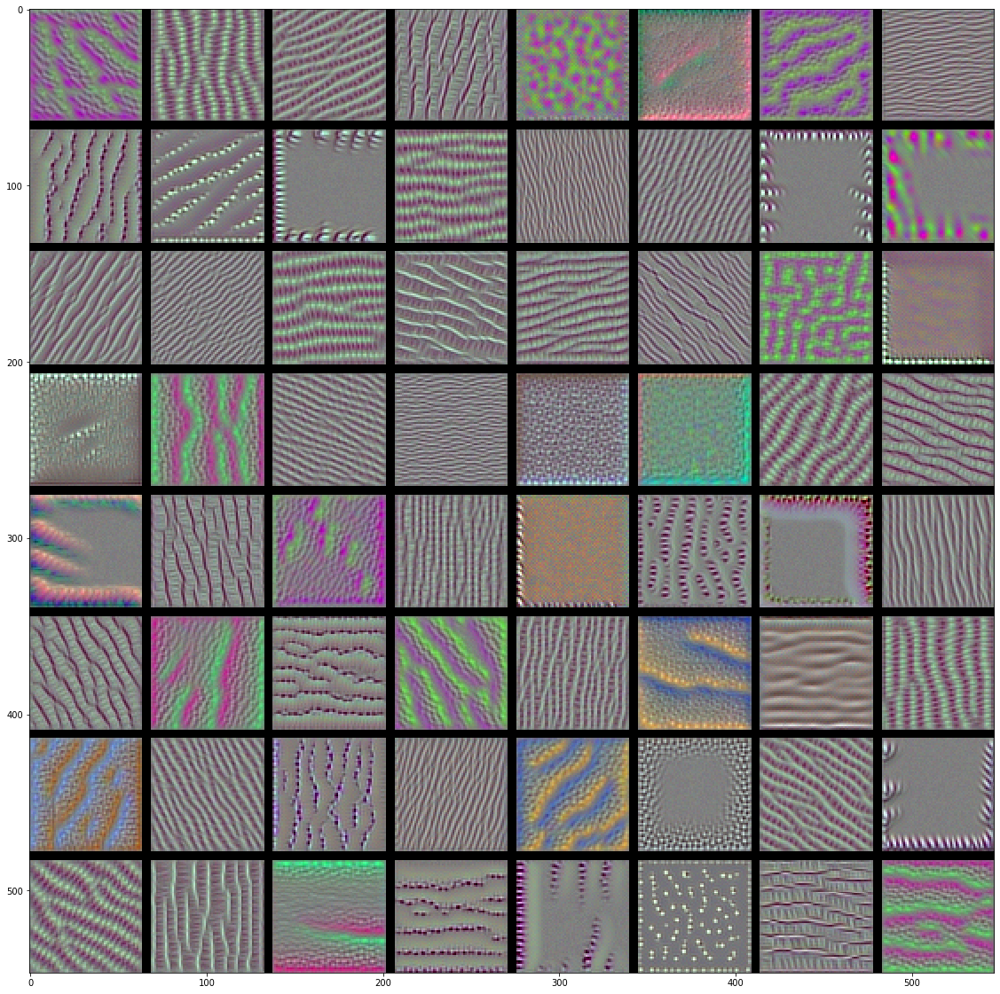

Visualizing layer block2_pool


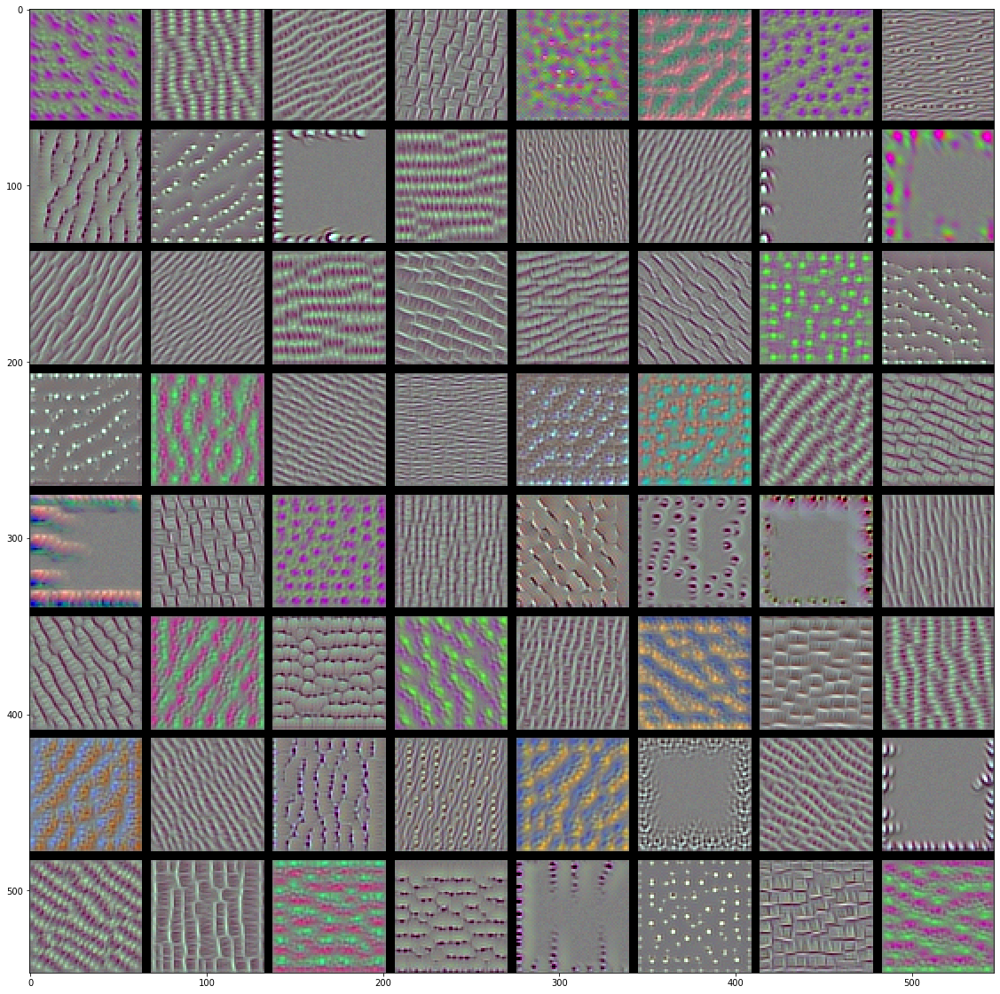

Visualizing layer block3_conv1


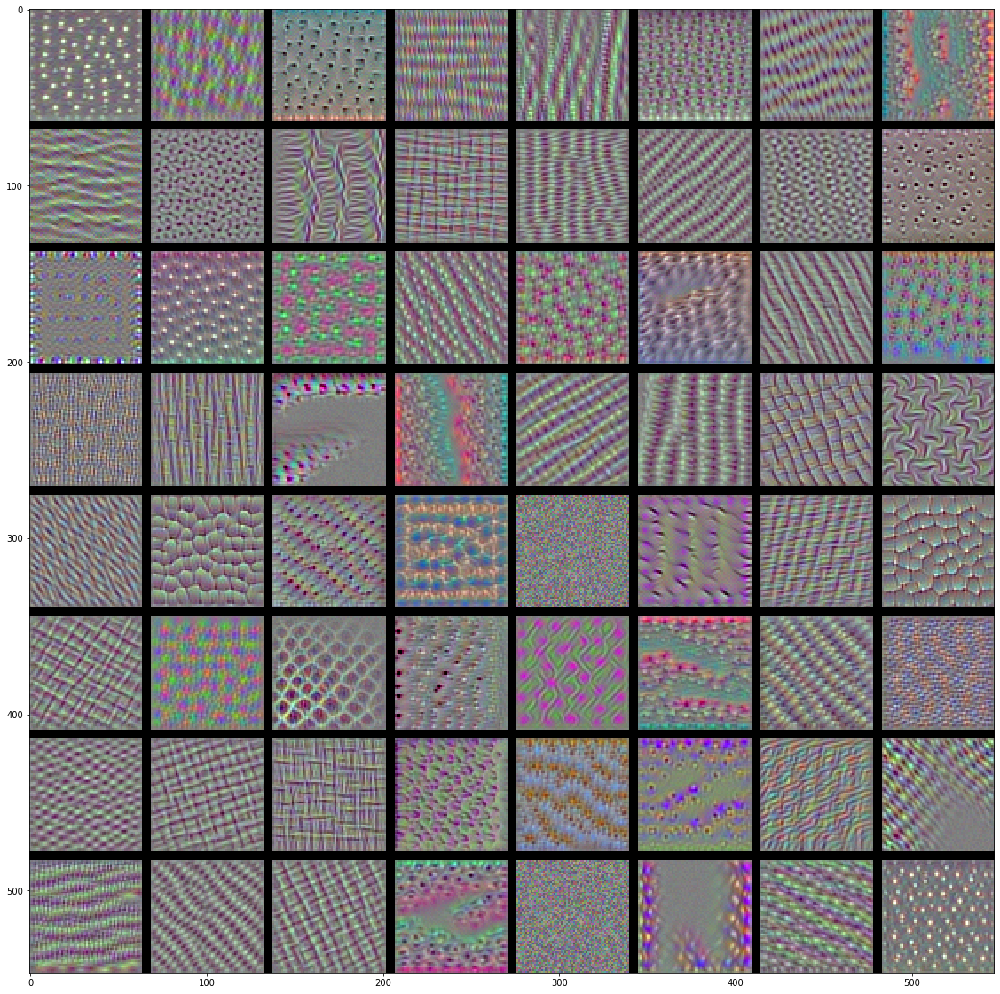

Visualizing layer block3_conv2


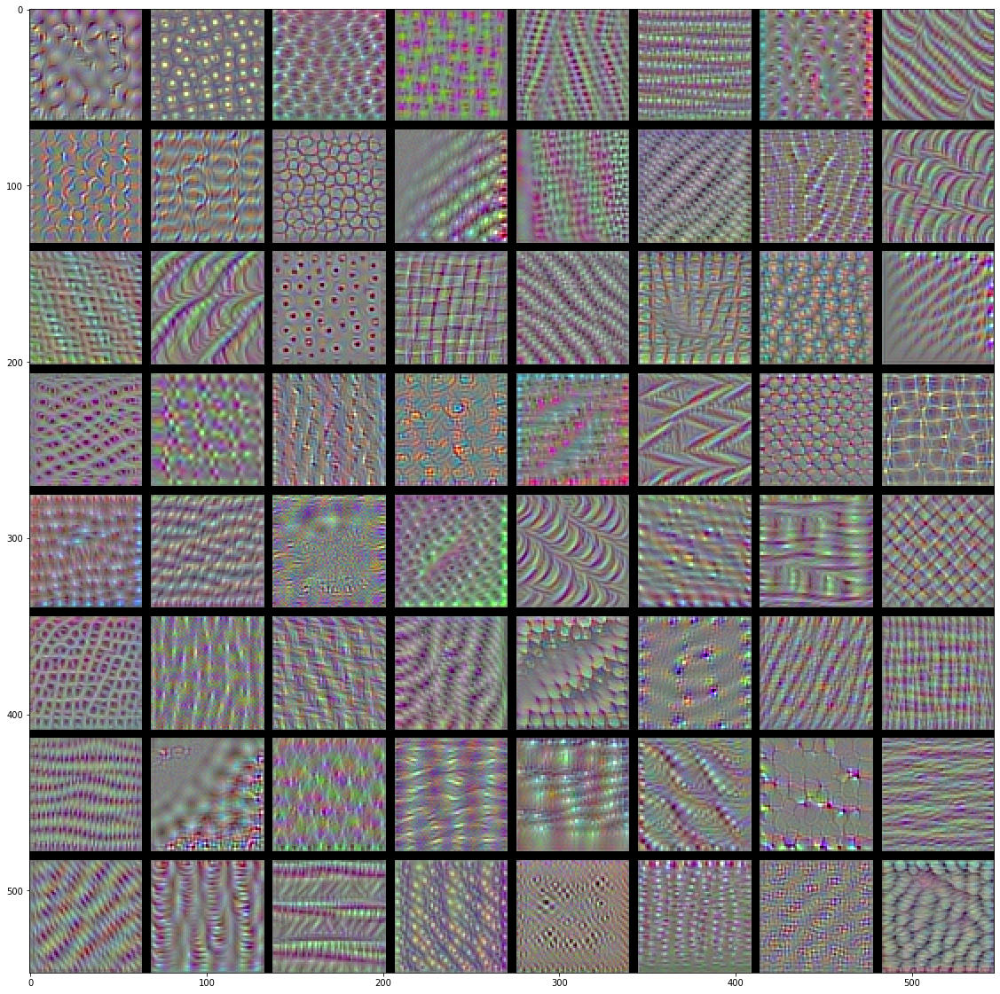

Visualizing layer block3_conv3


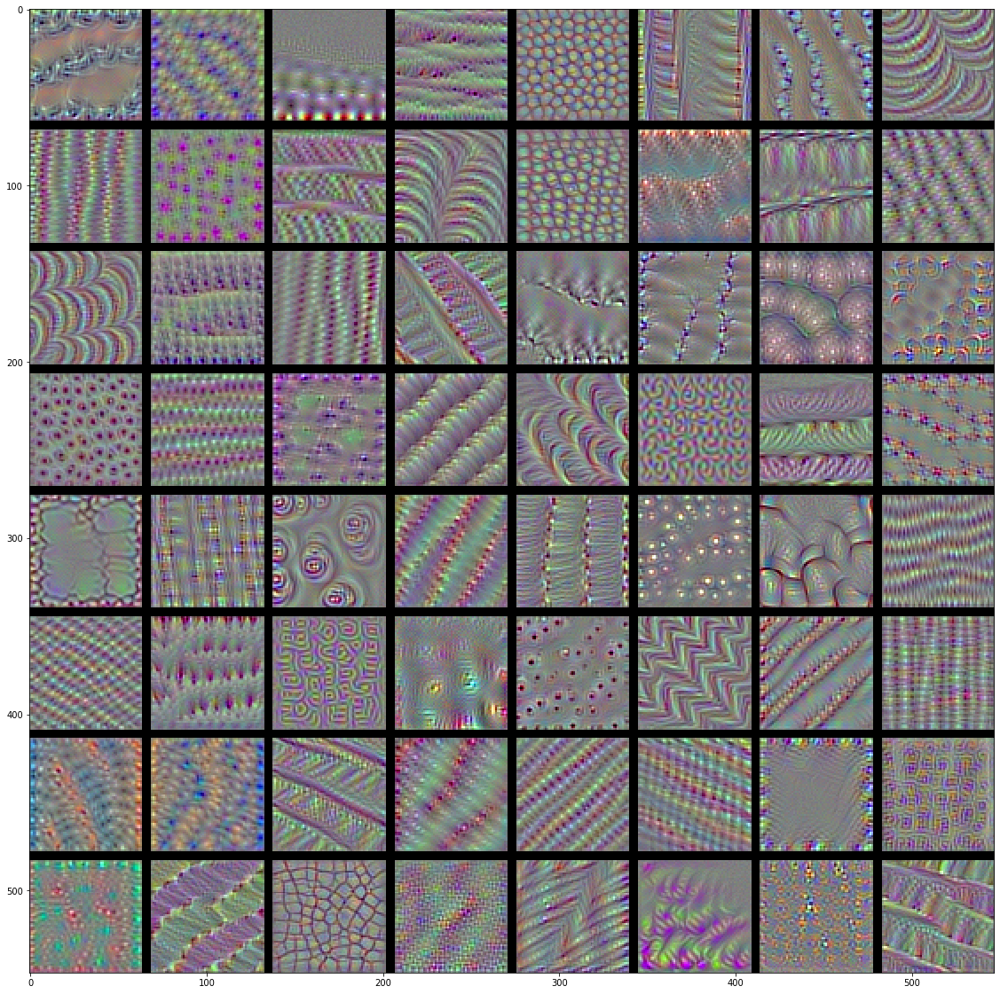

Visualizing layer block3_pool


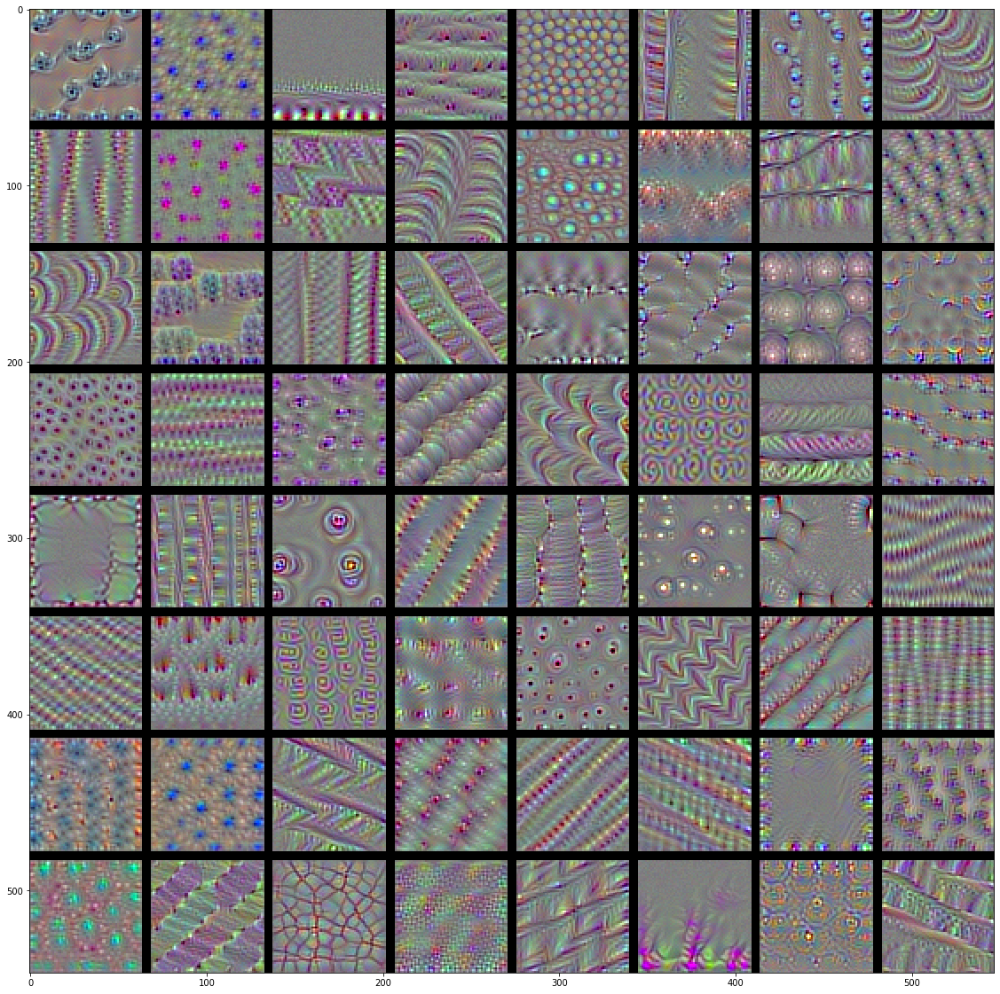

Visualizing layer block4_conv1


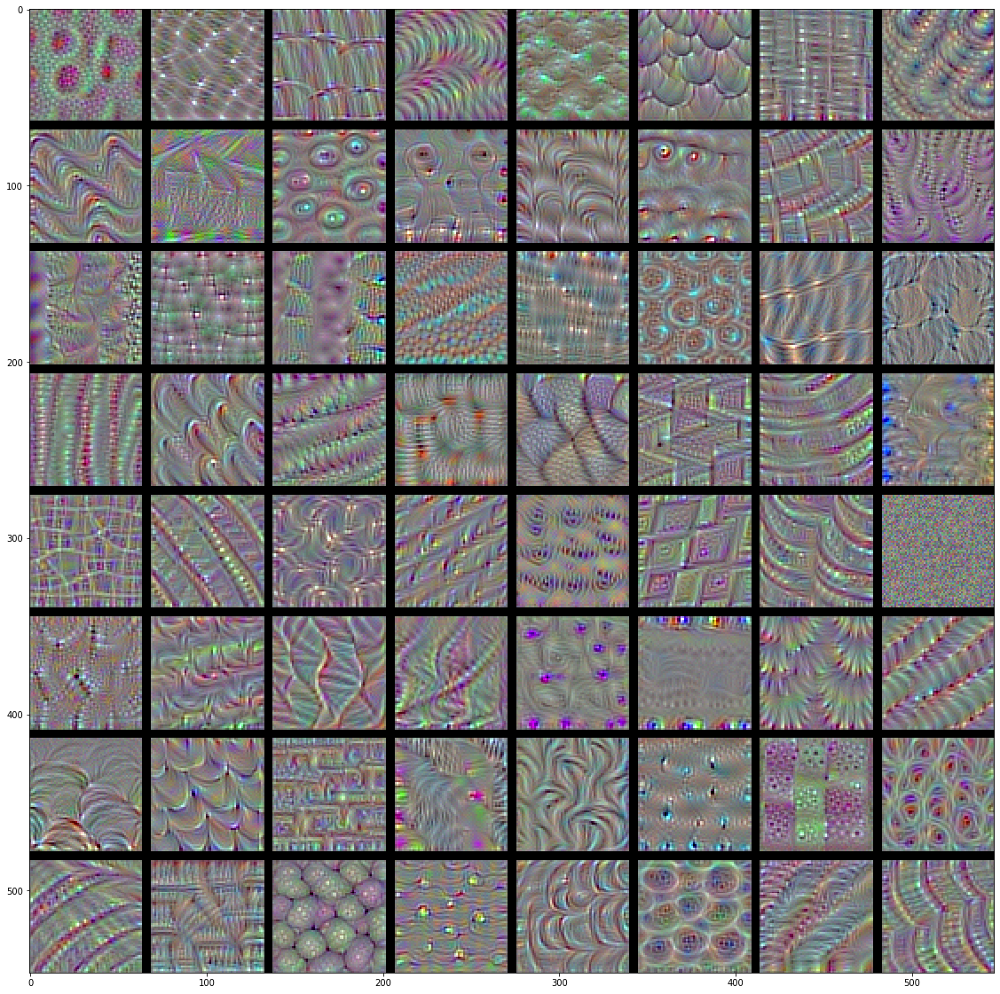

Visualizing layer block4_conv2


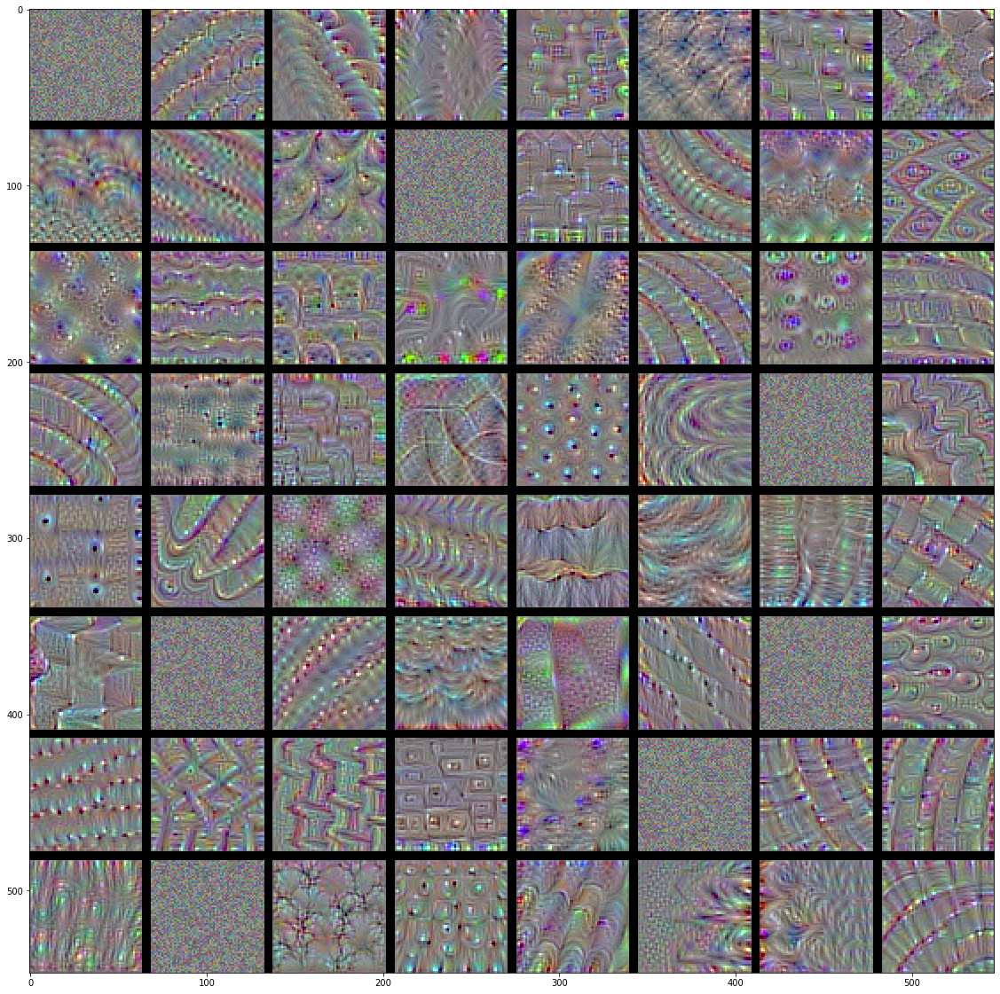

Visualizing layer block4_conv3


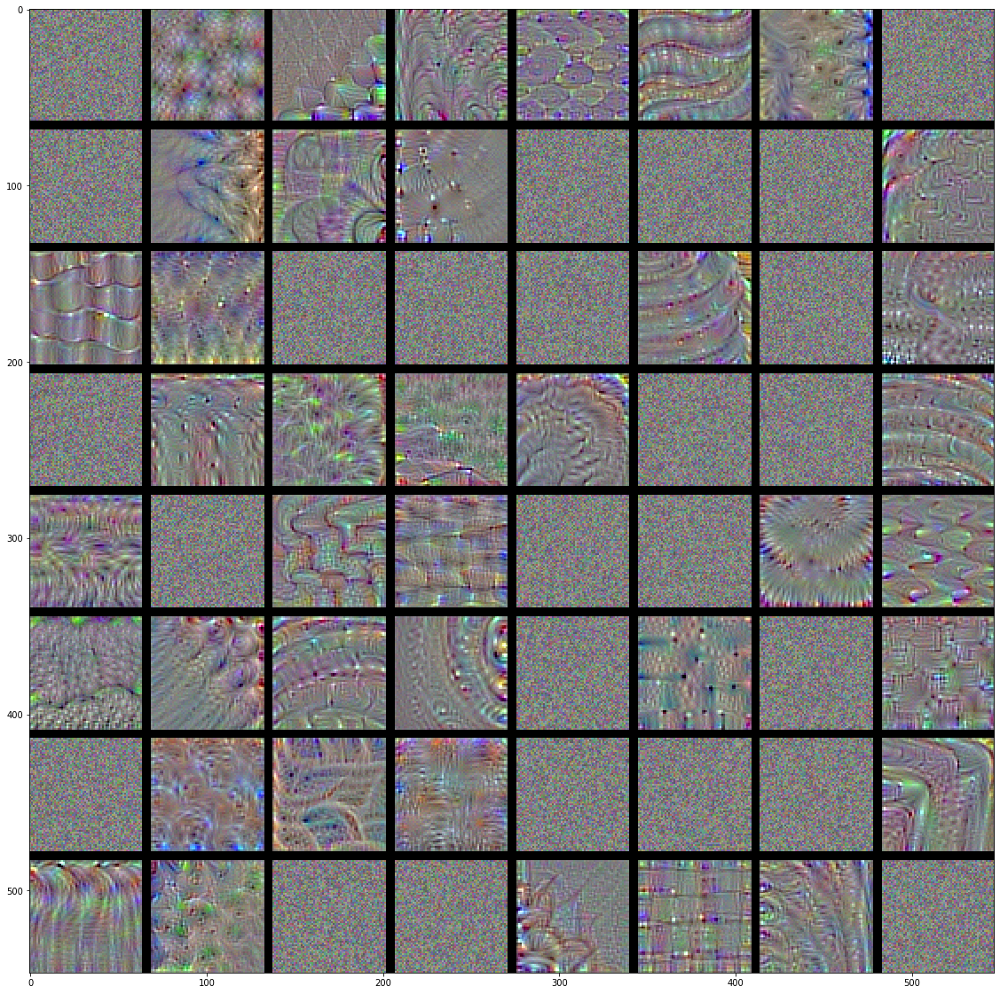

Visualizing layer block4_pool


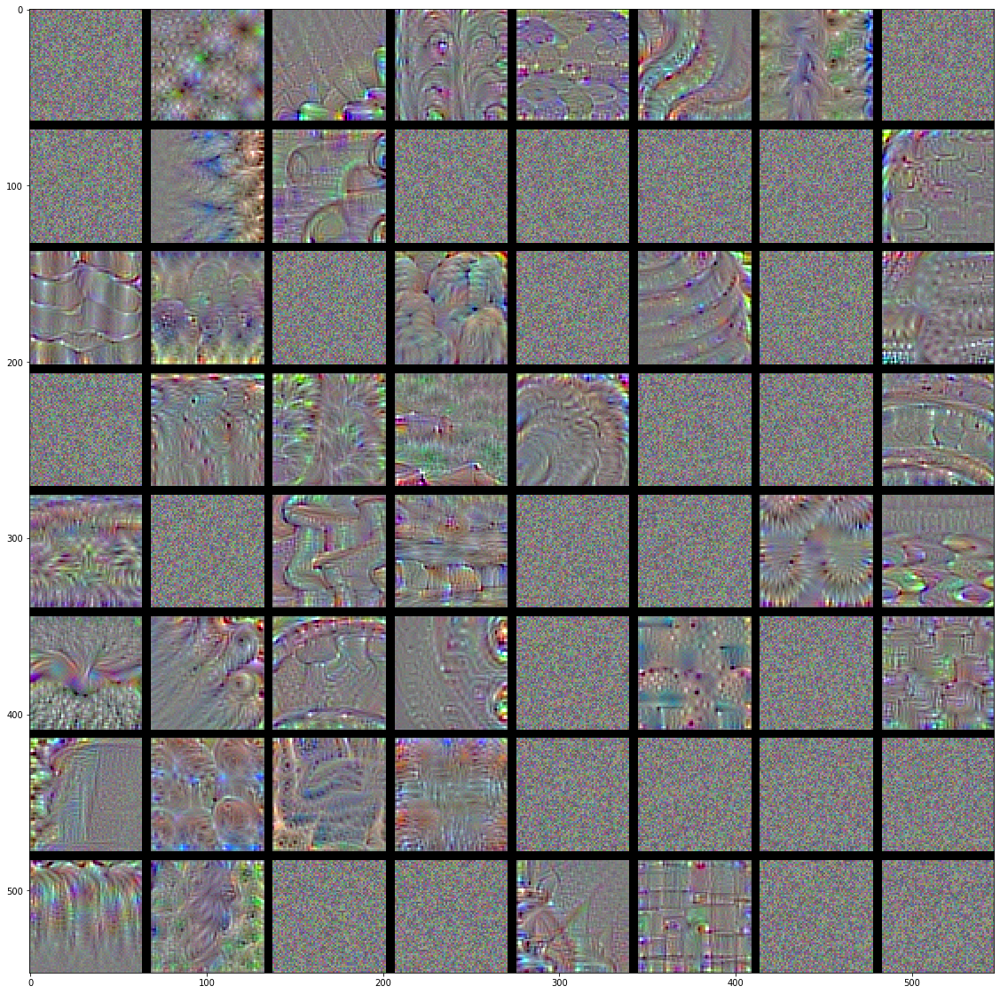

Visualizing layer block5_conv1


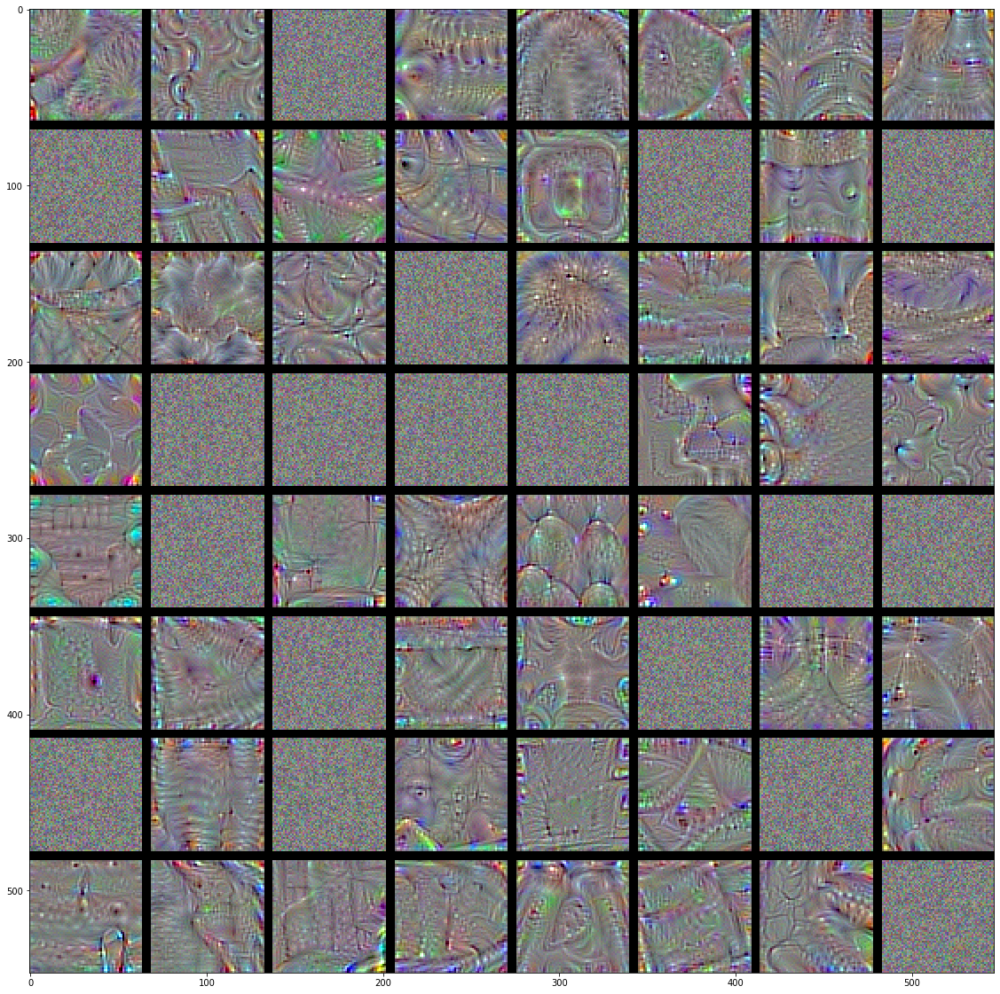

Visualizing layer block5_conv2


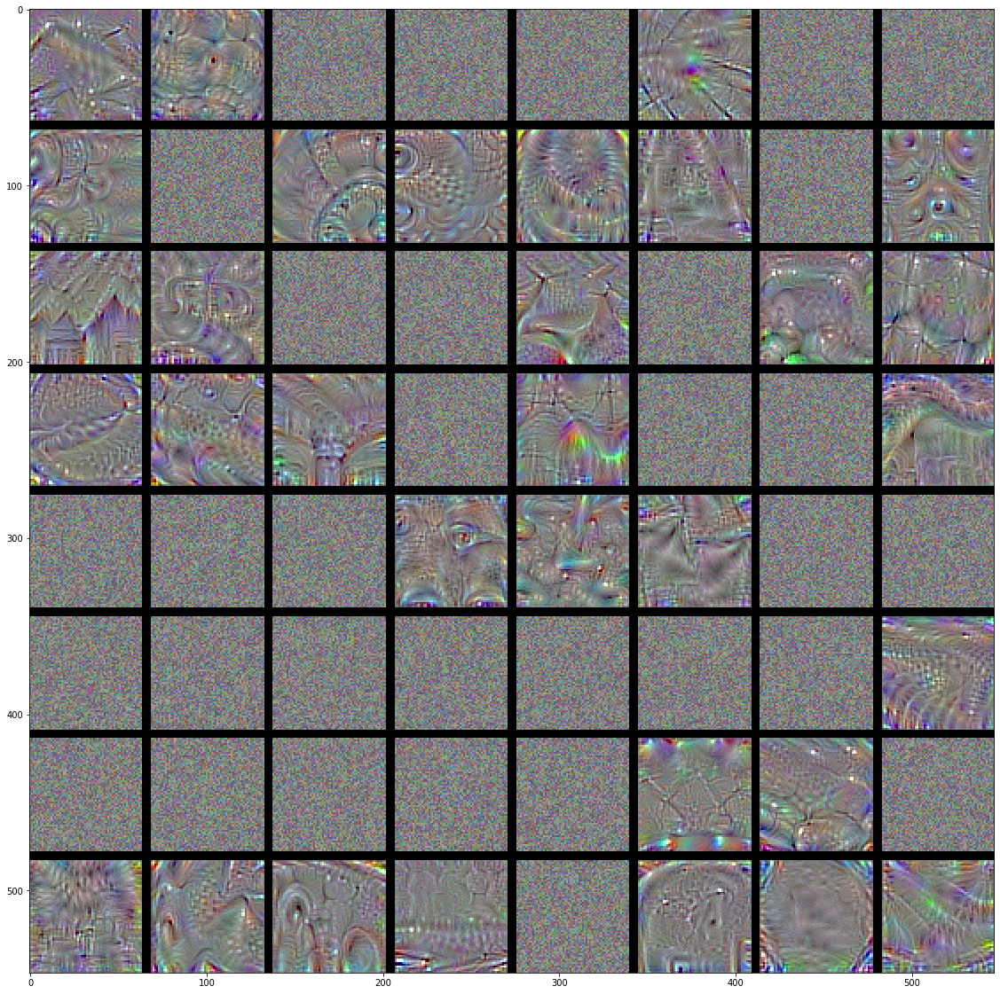

Visualizing layer block5_conv3


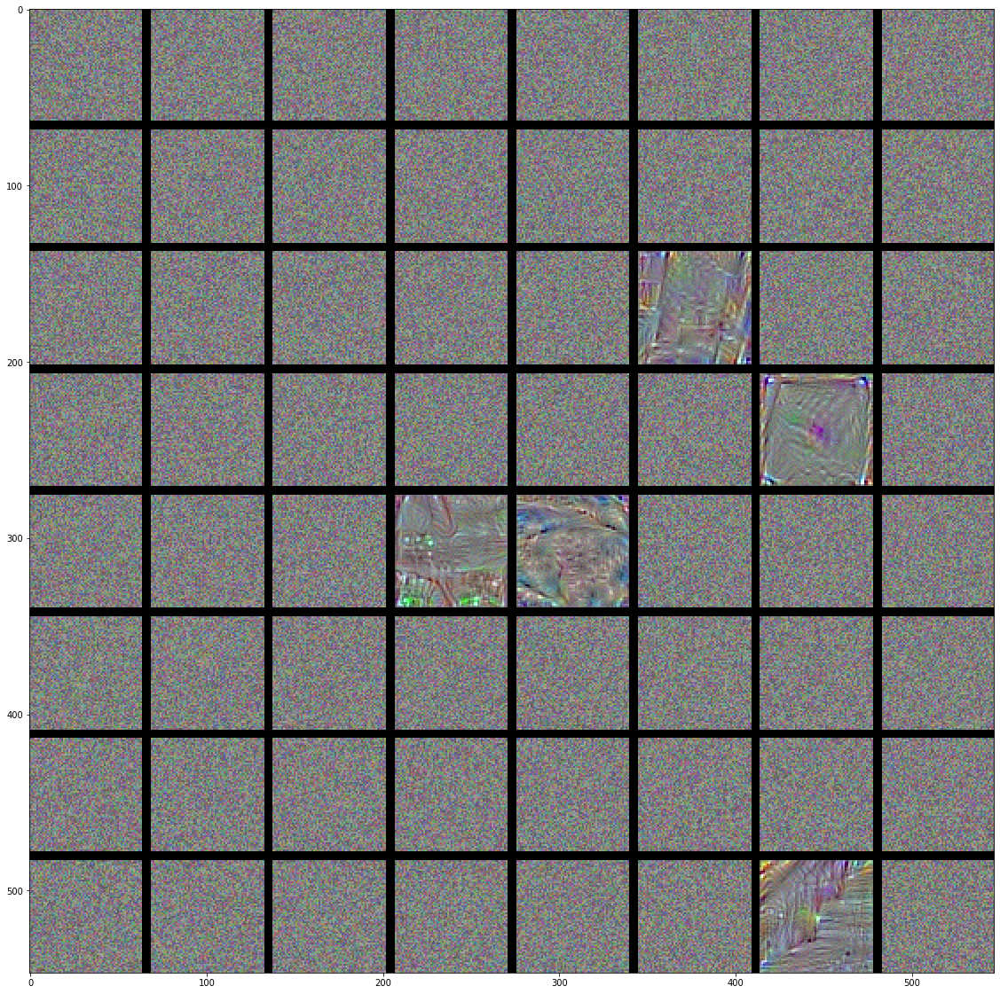

Visualizing layer block5_pool


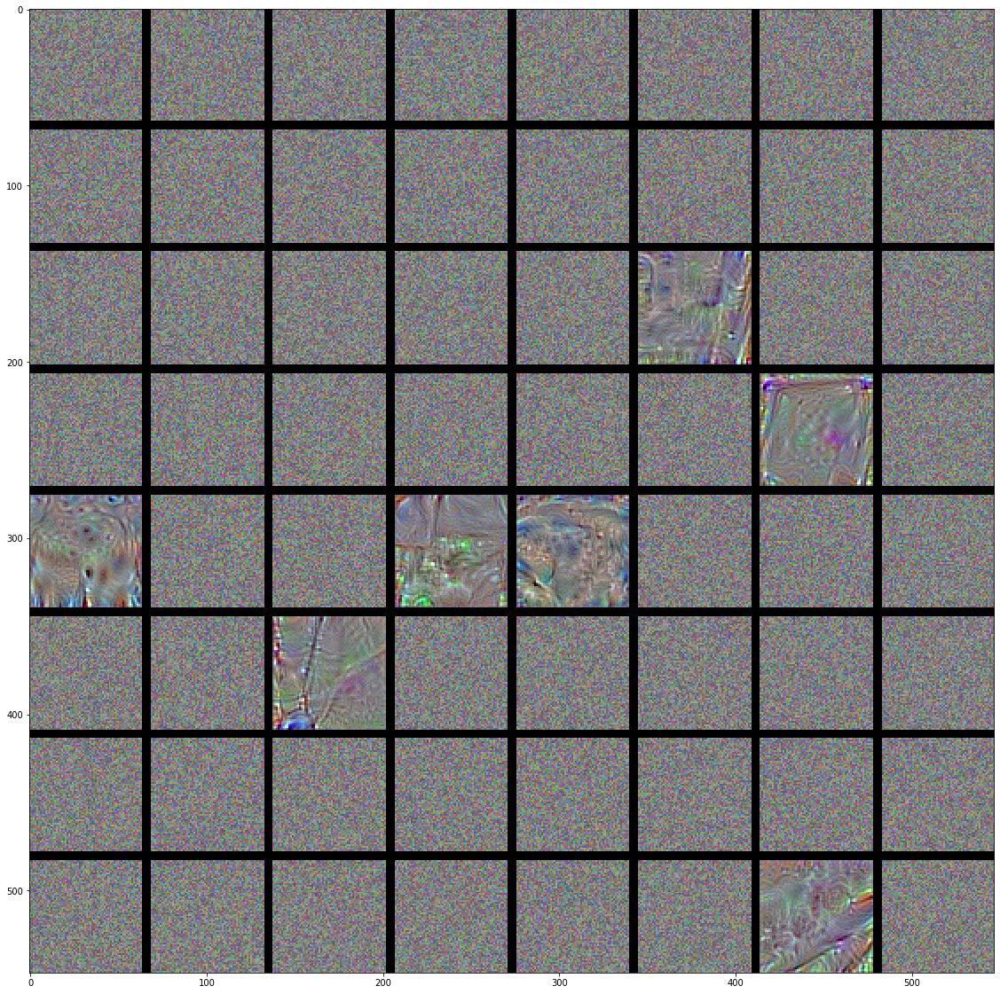

In [141]:
for layer_name in layer_names:
    print("Visualizing layer", layer_name)
    size = 64
    margin = 5

    results = np.zeros((8*size + 7*margin, 8*size + 7*margin, 3), dtype=np.uint8)

    for i in range(8):
        for j in range(8):
            filter_img = generate_pattern(layer_name, i+(j*8), size=size)

            horizontal_start = i*size + i*margin
            horizontal_end = horizontal_start + size
            vertical_start = j*size + j*margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end,
                    vertical_start: vertical_end, :] = filter_img
    
#     plt.title(f"Layer {layer_name}")
    plt.figure(figsize=(20, 20))
    plt.imsave(f"{layer_name}.png", results)
    plt.imshow(results)
    plt.show()

# Observation

I noticed some things based on the activations from the kernels in early layers.I noticed that the earlier the layers are, the more general or simplified the extracted features are. Moreover, the higher the layer, the more prominent the features are becoming. Similar to what CNN are introduced, it extracts features from the image, but for the last layers, it extracts features that are also coming from another features, therefore it can construct some deeper and more of a combination feature based on the classes that the model is going to predict.